In [ ]:
# Load the required packages
import scanpy as sc
import numpy as np
from matplotlib import pyplot as plt
import logging
from scipy.sparse import issparse
import anndata as ad
import celltypist
from celltypist import models
import scvi
from moscot.problems.time import TemporalProblem
import cellrank as cr
from cellrank.kernels import RealTimeKernel
import palantir
import scvelo as scv

sc.settings.set_figure_params(
    frameon=False,
    dpi=100,
    dpi_save=700,
    vector_friendly=False
)

In [2]:
### Load the required datasets: E12.5 and E16.5 (GSE153367), E13.5 and E17.5 (in-house data). ###
# We select these datasets due to several reasons. They are able to capture cells of the epicardial lineage via lineage tracing. They are all generated #
# using the 10X UMI-based technologies, preventing the introduction of the technical artifacts (sequencing depth and gene sensitivity, which can bias # 
# downstream analyses. #
e125 = sc.read("/mnt/sdb/qdang/singlecell/PRJNA647300/e125_quality_control.h5ad")
e135 = sc.read("/mnt/sdb/qdang/singlecell/epi/E135_analysis/e135_quality_control.h5ad")
e165 = sc.read("/mnt/sdb/qdang/singlecell/PRJNA647300/e165_quality_control.h5ad")
e175 = sc.read("/mnt/sdb/qdang/singlecell/epi/E175_analysis/e175_quality_control.h5ad")

In [4]:
adata = {"E12.5": e125, "E13.5": e135, "E16.5": e165, "E17.5": e175}
adata = ad.concat(adata, label="Batch", join="outer")
adata

/mnt/sdb/qdang/micromamba/envs/bioinfo/lib/python3.9/site-packages/anndata/_core/anndata.py:1838: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


AnnData object with n_obs × n_vars = 20790 × 19126
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'outlier', 'mt_outlier', 'scDblFinder_score', 'scDblFinder_class', 'Batch'
    layers: 'counts', 'soupX_counts'

In [6]:
adata.obs_names_make_unique()

AnnData object with n_obs × n_vars = 20790 × 19126
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'outlier', 'mt_outlier', 'scDblFinder_score', 'scDblFinder_class', 'Batch', 'n_genes'
    layers: 'counts', 'soupX_counts'

In [9]:
scales_counts = sc.pp.normalize_total(adata, target_sum=None, inplace=False)
# log1p transform the soupX-corrected counts, which is located in adata.X
adata.layers["log1p_norm"] = sc.pp.log1p(scales_counts["X"], copy=True)

In [15]:
adata.X = adata.layers['log1p_norm'].copy()

In [19]:
# Perform batch-aware HVG selection
sc.pp.highly_variable_genes(
    adata, n_top_genes=5000, flavor="cell_ranger", batch_key='Batch'
)
adata.var

,highly_variable,means,dispersions,dispersions_norm,highly_variable_nbatches,highly_variable_intersection
00R_AC107638.2,False,0.001477,0.195494,0.394832,1,False
0610005C13Rik,False,0.001590,0.337794,-0.187079,0,False
0610007P14Rik,False,0.248888,0.279989,-0.344638,0,False
0610009B22Rik,False,0.320379,0.590398,-0.893280,0,False
0610009E02Rik,False,0.013287,0.394265,0.077908,0,False
...,...,...,...,...,...,...
mt-Rnr1,False,0.573534,0.220051,0.147842,1,False
mt-Rnr2,False,1.141072,0.077962,-0.362512,0,False
mt-Tl1,False,0.006515,0.404232,0.247463,1,False
mt-Tq,False,0.006659,0.366159,-0.675968,0,False


0    9090
1    4344
2    2910
4    1490
3    1292
Name: highly_variable_nbatches, dtype: int64

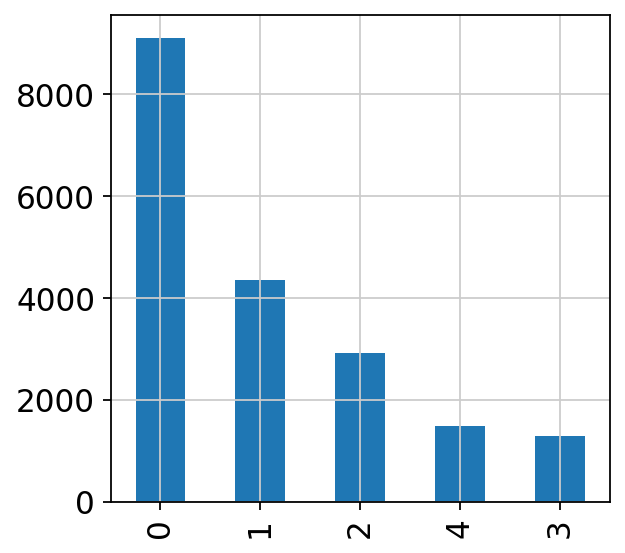

In [20]:
# Check how many batches each gene is variable in
n_batches = adata.var["highly_variable_nbatches"].value_counts()
ax = n_batches.plot(kind="bar")
n_batches

2025-07-21 10:47:00.138037: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-07-21 10:47:02.145428: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-07-21 10:47:02.145617: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-07-21 10:47:02.327318: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-07-21 10:47:02.800478: I tensorflow/core/platform/cpu_feature_guar

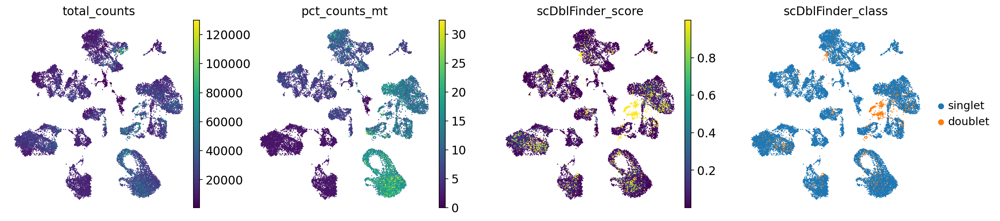

In [21]:
# Perform PCA, build neighborhood graph, and run UMAP dimensionality reduction
sc.pp.pca(adata, svd_solver="arpack", use_highly_variable=True)
sc.pp.neighbors(adata)
sc.tl.umap(adata)
sc.pl.umap(
    adata,
    color=["total_counts", "pct_counts_mt", "scDblFinder_score", "scDblFinder_class"],
)

/mnt/sdb/qdang/micromamba/envs/bioinfo/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/mnt/sdb/qdang/micromamba/envs/bioinfo/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/mnt/sdb/qdang/micromamba/envs/bioinfo/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


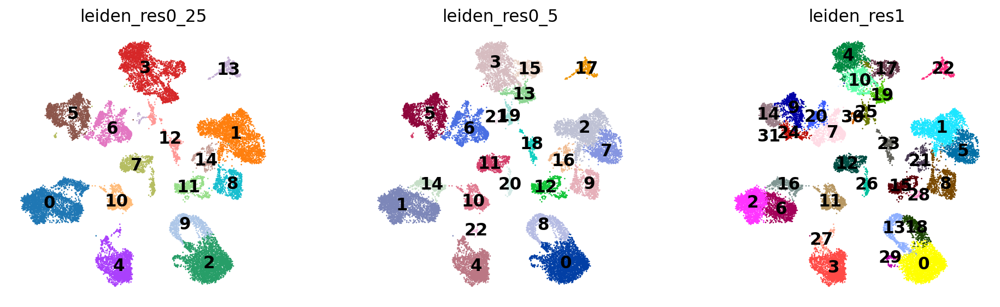

In [22]:
# Run leiden clustering with varying degree of resolutions
sc.tl.leiden(adata, key_added="leiden_res0_25", resolution=0.25)
sc.tl.leiden(adata, key_added="leiden_res0_5", resolution=0.5)
sc.tl.leiden(adata, key_added="leiden_res1", resolution=1.0)
sc.pl.umap(
    adata,
    color=["leiden_res0_25", "leiden_res0_5", "leiden_res1"],
    legend_loc="on data",
)

In [24]:
# Filter out the doublet cluster
adata2 = adata[-adata.obs['scDblFinder_class'].isin(['doublet'])]
adata2

View of AnnData object with n_obs × n_vars = 19493 × 19126
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'scDblFinder_score', 'scDblFinder_class', 'Batch', 'n_genes', 'leiden_res0_25', 'leiden_res0_5', 'leiden_res1'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'hvg', 'pca', 'neighbors', 'umap', 'scDblFinder_class_colors', 'leiden', 'leiden_res0_25_colors', 'leiden_res0_5_colors', 'leiden_res1_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'counts_combined', 'log1p_norm', 'soupX_counts'
    obsp: 'distances', 'connectivities'

In [25]:
# HVGs may change due to data filtering. Re-select HVGs in the subsetted data
sc.pp.highly_variable_genes(
    adata2, n_top_genes=5000, flavor="cell_ranger", batch_key='Batch'
)
adata2.var

/mnt/sdb/qdang/micromamba/envs/bioinfo/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:539: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns['hvg'] = {'flavor': flavor}


,highly_variable,means,dispersions,dispersions_norm,highly_variable_nbatches,highly_variable_intersection
00R_AC107638.2,False,0.001535,0.197558,0.360567,1,False
0610005C13Rik,False,0.001566,0.349299,-0.167841,0,False
0610007P14Rik,False,0.247896,0.283891,-0.352676,0,False
0610009B22Rik,False,0.318423,0.603294,-0.949681,0,False
0610009E02Rik,False,0.013039,0.402463,0.172464,1,False
...,...,...,...,...,...,...
mt-Rnr1,False,0.573385,0.223222,0.139874,1,False
mt-Rnr2,False,1.141357,0.079307,-0.367000,0,False
mt-Tl1,False,0.006507,0.410726,0.258962,2,False
mt-Tq,False,0.006455,0.371770,-0.676588,0,False


0    9062
1    4368
2    2926
4    1470
3    1300
Name: highly_variable_nbatches, dtype: int64

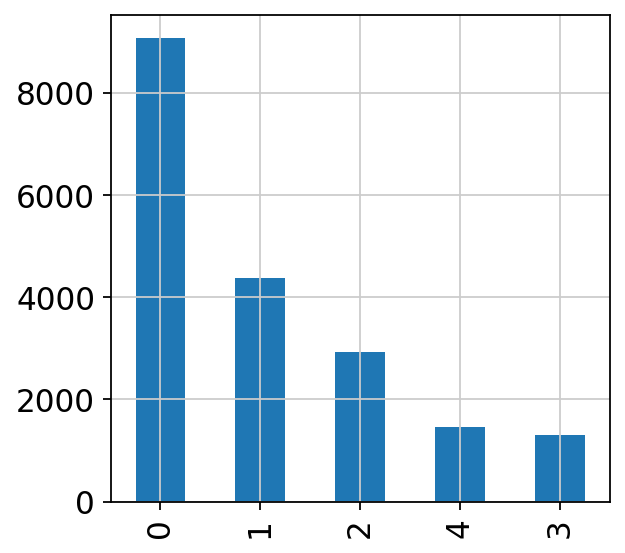

In [26]:
n_batches = adata2.var["highly_variable_nbatches"].value_counts()
ax = n_batches.plot(kind="bar")
n_batches

/mnt/sdb/qdang/micromamba/envs/bioinfo/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


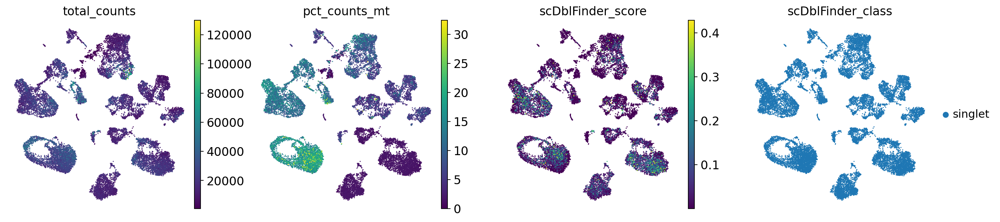

In [27]:
#Based on HVGs, run PCA and UMAP reduction again on the filtered dataset
sc.pp.pca(adata2, svd_solver="arpack", use_highly_variable=True)
sc.pp.neighbors(adata2)
sc.tl.umap(adata2)
sc.pl.umap(
    adata2,
    color=["total_counts", "pct_counts_mt", "scDblFinder_score", "scDblFinder_class"],
)

In [30]:
# Perform cell type annotation
adata_celltypist = adata2.copy()  # make a copy of our adata
adata_celltypist.X = adata2.layers["soupX_counts"]  # set adata.X to soupX-corrected counts
# make .X dense instead of sparse, for compatibility with celltypist:
adata_celltypist.X = adata_celltypist.X.toarray()

In [31]:
# Normalize to 10,000 counts per cell and log-transform
sc.pp.normalize_per_cell(
    adata_celltypist, counts_per_cell_after=10**4
)  
sc.pp.log1p(adata_celltypist)

In [32]:
# Perform preliminary cell type annotation using a prebuilt celltypist model of the mouse embryonic heart
predictions = celltypist.annotate(adata_celltypist, model = '/mnt/sdb/qdang/singlecell/epi/model_from_PRJNA795900.pkl', majority_voting = True)
predictions_adata = predictions.to_adata()
adata2.obs["celltypist_cell_label_PRJNA795900"] = predictions_adata.obs.loc[
    adata2.obs.index, "majority_voting"
]
adata2.obs["celltypist_conf_score_PRJNA795900"] = predictions_adata.obs.loc[
    adata2.obs.index, "conf_score"
]

🔬 Input data has 19493 cells and 19126 genes
🔗 Matching reference genes in the model
🧬 1917 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 10
🗳️ Majority voting the predictions
✅ Majority voting done!


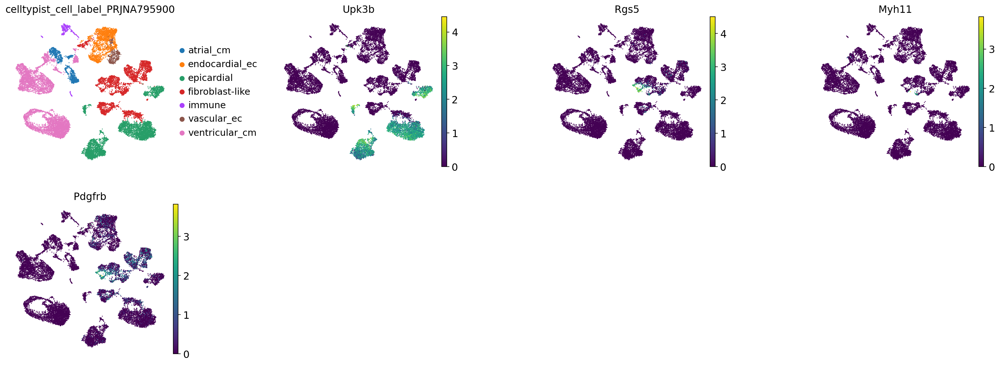

In [37]:
# Automated annotation is dependent on the trained model. The original model was trained on a pre-annotated dataset #
# that does not annotate mural cells. These cells are present in our dataset, indicated by expression of marker genes #
# Rgs5 (pericytes) and Myh11 (smooth muscle cells), but are currently labeled as fibroblast-like. Therefore, manual annotation is required. #
sc.pl.umap(
    adata2,
    color=["celltypist_cell_label_PRJNA795900",'Upk3b','Rgs5','Myh11','Pdgfrb'],
    frameon=False,
    sort_order=False,
    wspace=0.5,
)

In [51]:
# Modify CellTypist annotation, annotating mural cells based on their expression of Pdgfrb
initial_cell_type = 'fibroblast-like'
marker_gene = 'Pdgfrb'
expression_threshold = 2.0  # Choose based on your violin plot
new_cell_type = 'mural' # The new, more specific name
column_to_modify = 'celltypist_cell_label_PRJNA795900'

# Check if the new category already exists before adding
if new_cell_type not in adata2.obs[column_to_modify].cat.categories:
    print(f"Adding new category '{new_cell_type}' to column '{column_to_modify}'.")
    # Use .cat.add_categories to add the new level
    adata3.obs[column_to_modify] = adata2.obs[column_to_modify].cat.add_categories([new_cell_type])

# Create a boolean mask for the specific cells to change
# Condition 1: Cell is within an annotation group (fibroblast-like)
is_initial_type = adata2.obs['celltypist_cell_label_PRJNA795900'] == initial_cell_type
# Condition 2: Marker expression is above the threshold
has_high_expression = adata2[:, marker_gene].X.toarray().flatten() > expression_threshold

# Combine both conditions using the AND (&) operator
final_mask = is_initial_type & has_high_expression

# Use the mask to update the existing column ---
# .loc ensures you are safely modifying the original dataframe
adata2.obs.loc[final_mask, 'celltypist_cell_label_PRJNA795900'] = new_cell_type

# Check the result
print("Updated cell type counts:")
print(adata2.obs['celltypist_cell_label_PRJNA795900'].value_counts())

Adding new category 'mural' to column 'celltypist_cell_label_PRJNA795900'.
Updated cell type counts:
ventricular_cm     6643
epicardial         5003
fibroblast-like    3719
endocardial_ec     2172
atrial_cm           961
vascular_ec         470
immune              325
mural               200
Name: celltypist_cell_label_PRJNA795900, dtype: int64


In [52]:
# Modify CellTypist annotation, annotating pericytes based on their expression of Rgs5
initial_cell_type = 'mural'
marker_gene = 'Rgs5'
expression_threshold = 2.0  # Choose based on your violin plot
new_cell_type = 'pericyte' # The new, more specific name
column_to_modify = 'celltypist_cell_label_PRJNA795900'

# Check if the new category already exists before adding
if new_cell_type not in adata3.obs[column_to_modify].cat.categories:
    print(f"Adding new category '{new_cell_type}' to column '{column_to_modify}'.")
    # Use .cat.add_categories to add the new level
    adata3.obs[column_to_modify] = adata3.obs[column_to_modify].cat.add_categories([new_cell_type])

# Create a boolean mask for the specific cells to change
# Condition 1: Cell is within an annotation group (fibroblast-like)
is_initial_type = adata2.obs['celltypist_cell_label_PRJNA795900'] == initial_cell_type
# Condition 2: Marker expression is above the threshold
has_high_expression = adata2[:, marker_gene].X.toarray().flatten() > expression_threshold

# Combine both conditions using the AND (&) operator
final_mask = is_initial_type & has_high_expression

# Use the mask to update the existing column ---
# .loc ensures you are safely modifying the original dataframe
adata2.obs.loc[final_mask, 'celltypist_cell_label_PRJNA795900'] = new_cell_type

# --- 4. Check the result ---
print("Updated cell type counts:")
print(adata2.obs['celltypist_cell_label_PRJNA795900'].value_counts())

Adding new category 'pericyte' to column 'celltypist_cell_label_PRJNA795900'.
Updated cell type counts:
ventricular_cm     6643
epicardial         5003
fibroblast-like    3719
endocardial_ec     2172
atrial_cm           961
vascular_ec         470
immune              325
mural               110
pericyte             90
Name: celltypist_cell_label_PRJNA795900, dtype: int64


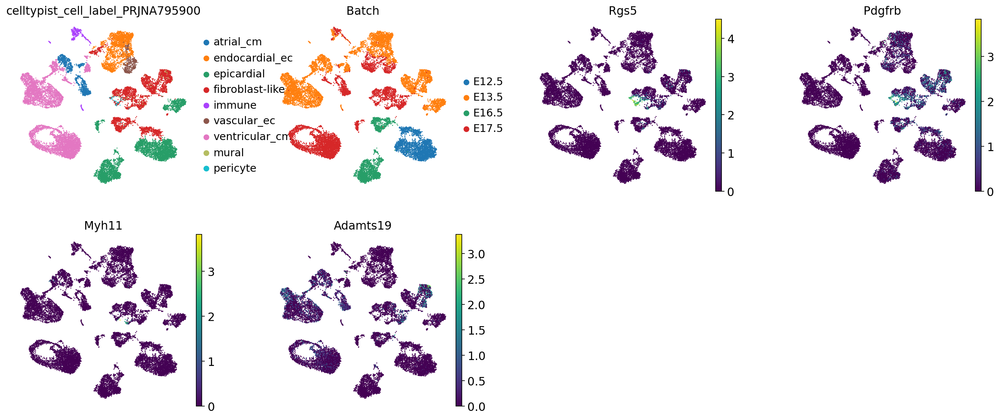

In [47]:
sc.pl.umap(
    adata2,
    color=["celltypist_cell_label_PRJNA795900",'Batch','Rgs5','Pdgfrb','Myh11','Adamts19'],
    frameon=False,
    sort_order=False,
    wspace=0.3,
)

In [3]:
# Set .X to the soupX-corrected counts. Save the data to .raw layer (this is to preserve the original anndata object, ensuring we can still retrieve it #
# after fitering for only HVGs below #
adata2.X = adata2.layers["soupX_counts"].copy()
adata2.raw = adata2

In [4]:
# Filter for only HVGs to improve the performance of integration. Autovariational encoders' performances deteriorate when the number of genes is #
# equal to the number of cells # 
adata = adata2[:, adata2.var["highly_variable"]].copy()
adata

AnnData object with n_obs × n_vars = 19493 × 5000
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'scDblFinder_score', 'scDblFinder_class', 'Batch', 'n_genes', 'leiden_res0_25', 'leiden_res0_5', 'leiden_res1', 'celltypist_cell_label_PRJNA795900', 'celltypist_conf_score_PRJNA795900'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'hvg', 'leiden', 'leiden_res0_25_colors', 'leiden_res0_5_colors', 'leiden_res1_colors', 'neighbors', 'pca', 'scDblFinder_class_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'counts_combined', 'log1p_norm', 'soupX_counts'
    obsp: 'connectivities', 'distances'

In [8]:
# Run integration using scVI. Provide scVI with raw counts. Save the trained scVI model for further use with scANVI - an extension of scVI that leverages #
# cell type annotation #

scvi.model.SCVI.setup_anndata(adata, layer="soupX_counts", batch_key="Batch")
vae = scvi.model.SCVI(adata, gene_likelihood="nb", n_layers=2, n_latent=30)
vae.train()
adata.obsm["scVI"] = vae.get_latent_representation()

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 400/400: 100%|█| 400/400 [09:01<00:00,  1.39s/it, v_num=1, train_loss_step=2.4e+3, train_loss_epoch

`Trainer.fit` stopped: `max_epochs=400` reached.


Epoch 400/400: 100%|█| 400/400 [09:01<00:00,  1.35s/it, v_num=1, train_loss_step=2.4e+3, train_loss_epoch


In [9]:
# Train the scANVI model
lvae = scvi.model.SCANVI.from_scvi_model(
    vae,
    adata=adata,
    labels_key="celltypist_cell_label_PRJNA795900",
    unlabeled_category="Unknown",
)
lvae.train(max_epochs=20, n_samples_per_label=100)
adata.obsm["scANVI"] = lvae.get_latent_representation()

INFO     Training for 20 epochs.                                                                                   


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 20/20: 100%|█| 20/20 [01:11<00:00,  3.59s/it, v_num=1, train_loss_step=2.64e+3, train_loss_epoch=2.

`Trainer.fit` stopped: `max_epochs=20` reached.


Epoch 20/20: 100%|█| 20/20 [01:11<00:00,  3.59s/it, v_num=1, train_loss_step=2.64e+3, train_loss_epoch=2.


In [10]:
label_key = 'celltypist_cell_label_PRJNA795900'
batch_key = 'Batch'

/home/qdang/micromamba/envs/bioinfo/lib/python3.9/site-packages/pynndescent/pynndescent_.py:346: NumbaPendingDeprecationWarning: Code using Numba extension API maybe depending on 'old_style' error-capturing, which is deprecated and will be replaced by 'new_style' in a future release. See details at https://numba.readthedocs.io/en/latest/reference/deprecation.html#deprecation-of-old-style-numba-captured-errors
Exception origin:
  File "/home/qdang/micromamba/envs/bioinfo/lib/python3.9/site-packages/numba/core/types/functions.py", line 486, in __getnewargs__
    raise ReferenceError("underlying object has vanished")

  init_rp_tree(data, dist, current_graph, leaf_array)
/home/qdang/micromamba/envs/bioinfo/lib/python3.9/site-packages/pynndescent/pynndescent_.py:348: NumbaPendingDeprecationWarning: Code using Numba extension API maybe depending on 'old_style' error-capturing, which is deprecated and will be replaced by 'new_style' in a future release. See details at https://numba.readthedo

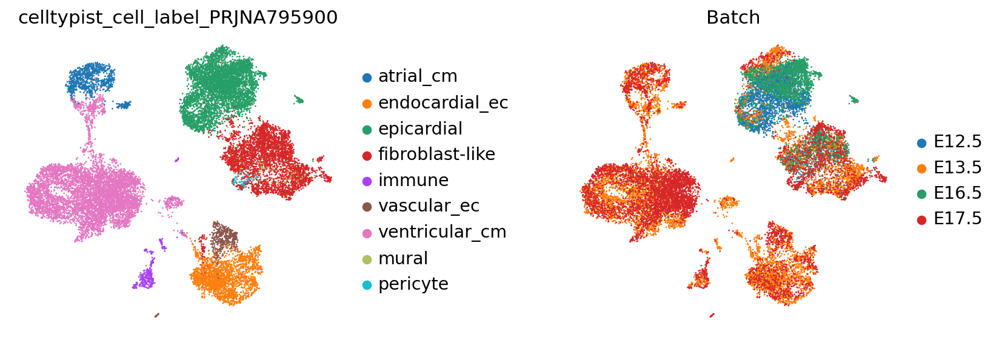

In [12]:
# Extract the scANVI-calculated batch-corrected embedding, detect neighborhood graph using this updated embedding, and rerun UMAP 
sc.pp.neighbors(adata, use_rep='scANVI')
sc.tl.umap(adata)
sc.pl.umap(adata, color=[label_key, batch_key], frameon=False, wspace=0.5)

In [15]:
sc.tl.leiden(adata, key_added="leiden_res0_25", resolution=0.25)
sc.tl.leiden(adata, key_added="leiden_res0_5", resolution=0.5)
sc.tl.leiden(adata, key_added="leiden_res1", resolution=1.0)
sc.tl.leiden(adata, key_added="leiden_res1_25", resolution=1.25)
sc.tl.leiden(adata, key_added="leiden_res1_5", resolution=1.5)

/home/qdang/micromamba/envs/bioinfo/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/qdang/micromamba/envs/bioinfo/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/qdang/micromamba/envs/bioinfo/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


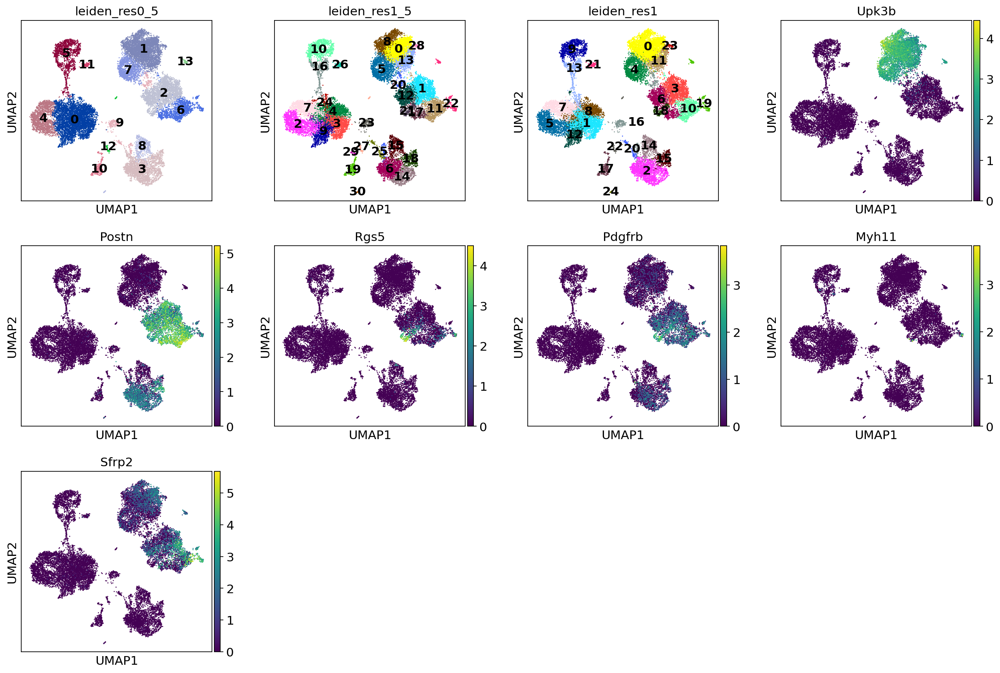

In [17]:
sc.pl.umap(
    adata,
    color=['leiden_res0_5','leiden_res1_5',"leiden_res1",'Upk3b','Postn','Rgs5','Pdgfrb','Myh11','Sfrp2'],layer='log1p_norm',
    legend_loc="on data",
)

In [20]:
# Filter the dataset to retain only cells likely to be part of the epicardial lineage
emt = adata[adata.obs['leiden_res0_5'].isin(['1','7','2','6'])].copy()
emt

AnnData object with n_obs × n_vars = 8716 × 5000
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'scDblFinder_score', 'scDblFinder_class', 'Batch', 'n_genes', 'leiden_res0_25', 'leiden_res0_5', 'leiden_res1', 'celltypist_cell_label_PRJNA795900', 'celltypist_conf_score_PRJNA795900', '_scvi_batch', '_scvi_labels', 'leiden_res1_25', 'leiden_res1_5'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'hvg', 'leiden', 'neighbors', 'pca', 'scDblFinder_class_colors', 'umap', '_scvi_uuid', '_scvi_manager_uuid', 'celltypist_cell_label_PRJNA795900_colors', 'Batch_colors', 'leiden_res1_5_colors'
    obsm: 'X_pca', 'X_umap', 'scVI', 'scANVI'
    varm

In [21]:
# Due to subsetting, we need to re-normalise the data
emt.X = emt.layers['soupX_counts'].copy()
scales_counts = sc.pp.normalize_total(emt, target_sum=None, inplace=False)
emt.layers["log1p_norm"] = sc.pp.log1p(scales_counts["X"], copy=True)

/home/qdang/micromamba/envs/bioinfo/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/qdang/micromamba/envs/bioinfo/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


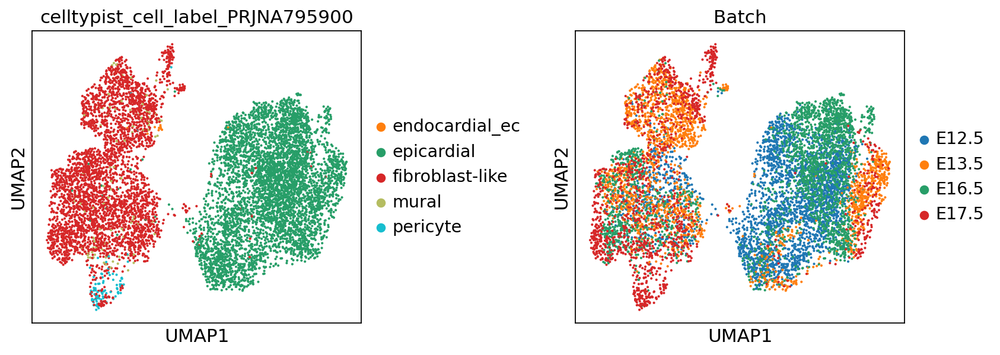

In [23]:
####This was after
emt.X = emt.layers["log1p_norm"]
sc.pp.neighbors(emt, use_rep='scANVI')
sc.tl.umap(emt)
sc.pl.umap(emt, color=['celltypist_cell_label_PRJNA795900', 'Batch'], wspace=0.5)

/home/qdang/micromamba/envs/bioinfo/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


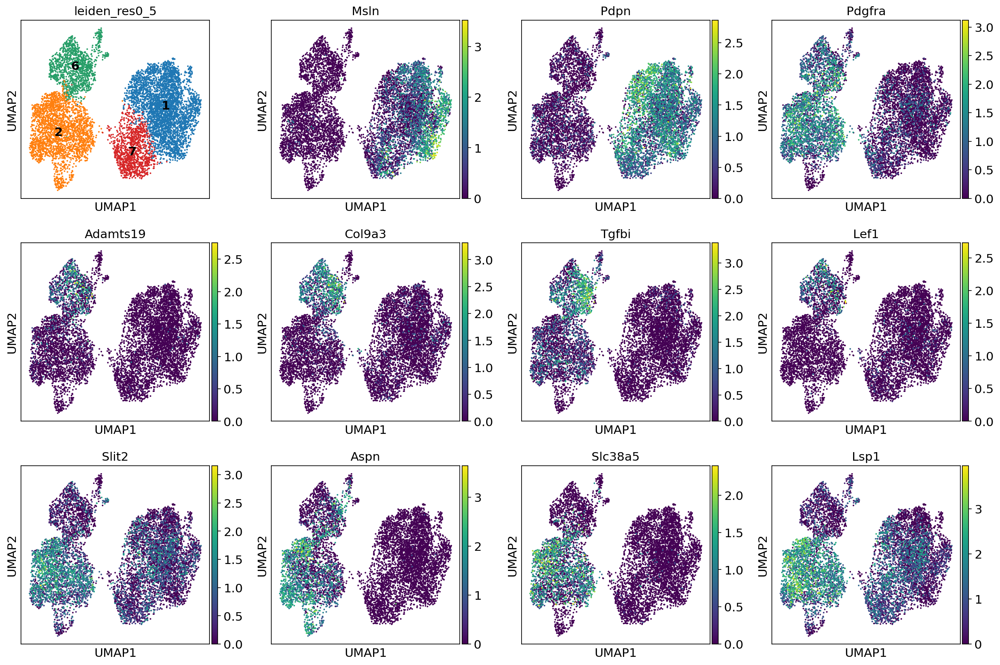

In [30]:
sc.pl.umap(emt, color=['leiden_res0_5', 'Msln','Pdpn', # Markers pf epicardial cells 
                        'Adamts19','Col9a3','Tgfbi','Lef1', # Markers of valvular interstitial cells
                        'Slit2','Aspn','Slc38a5','Lsp1'],layer='log1p_norm',legend_loc='on data') # Markers of EPDCs

In [37]:
sc.tl.leiden(emt, key_added='leiden_res0_25', resolution=0.25)
sc.tl.leiden(emt, key_added='leiden_res0_5', resolution=0.5)

/home/qdang/micromamba/envs/bioinfo/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/qdang/micromamba/envs/bioinfo/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/qdang/micromamba/envs/bioinfo/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


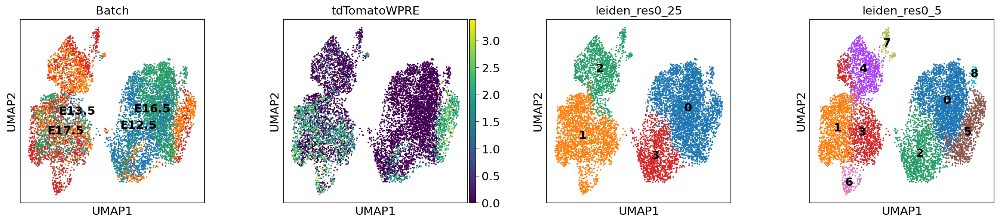

In [39]:
sc.pl.umap(emt, color=['Batch','tdTomatoWPRE','leiden_res0_25','leiden_res0_5'], layer='log1p_norm', wspace=0.3, legend_loc='on data')

### The section below is to filter the dataset to retain only derivatives that are part of the epicardial lineages. This is necessary to exclude mesenchymal derivatives from non-epicardial lineages. 

In [94]:
import scanpy as sc
emt = sc.read('/mnt/sdb/qdang/singlecell/epi/integrated/emt/concat_normalized_noess2_annotated_updated_scanvi_emtonly.h5ad')

In [95]:
# Filter for EPDCs
sc.tl.leiden(emt, key_added='leiden_res0_25', resolution=0.25)
sc.tl.leiden(emt, key_added='leiden_res0_5', resolution=0.5)
epdc = emt[emt.obs['leiden_res0_25'].isin(['1','2'])].copy()
epdc

AnnData object with n_obs × n_vars = 3749 × 5000
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'scDblFinder_score', 'scDblFinder_class', 'Batch', 'n_genes', 'leiden_res0_25', 'leiden_res0_5', 'leiden_res1', 'celltypist_cell_label_PRJNA795900', 'celltypist_conf_score_PRJNA795900', '_scvi_batch', '_scvi_labels', 'leiden_res1_25', 'leiden_res1_5'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'Batch_colors', '_scvi_manager_uuid', '_scvi_uuid', 'celltypist_cell_label_PRJNA795900_colors', 'hvg', 'leiden', 'leiden_res1_5_colors', 'neighbors', 'pca', 'scDblFinder_class_colors', 'umap'
    obsm: 'X_pca', 'X_umap', 'scANVI', 'scVI'
    varm

In [96]:
# Filter for EPDCs
epdc = emt[emt.obs['leiden_res0_25'].isin(['1','2'])].copy()
epdc

AnnData object with n_obs × n_vars = 3749 × 5000
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'scDblFinder_score', 'scDblFinder_class', 'Batch', 'n_genes', 'leiden_res0_25', 'leiden_res0_5', 'leiden_res1', 'celltypist_cell_label_PRJNA795900', 'celltypist_conf_score_PRJNA795900', '_scvi_batch', '_scvi_labels', 'leiden_res1_25', 'leiden_res1_5'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'Batch_colors', '_scvi_manager_uuid', '_scvi_uuid', 'celltypist_cell_label_PRJNA795900_colors', 'hvg', 'leiden', 'leiden_res1_5_colors', 'neighbors', 'pca', 'scDblFinder_class_colors', 'umap'
    obsm: 'X_pca', 'X_umap', 'scANVI', 'scVI'
    varm

In [97]:
import pandas as pd
gene = "tdTomatoWPRE"
batches_to_filter = ["E13.5", "E17.5"]  # change as needed
# Set .X to raw counts
epdc.X = epdc.layers['soupX_counts'].copy()
# Extract expression (dense or sparse handling)
expr = epdc[:, gene].X
if hasattr(expr, 'toarray'):
    expr = expr.toarray().flatten()

# Create DataFrame with batch info and expression
df = pd.DataFrame({
    'batch': epdc.obs['Batch'].values,
    'expresses': expr > 0
})

In [98]:
# Calculate percentage of cells that express the tdTomato reporter. The E12.5 and E16.5 data are cells that were sorted based on tdTomato expression #
# in Wt1CreERT2 mice, so they represent the epicardial lineage despite the absence of expression of tdTomato. In this context, no filtering is needed. 
pct_expr_by_batch = df.groupby('batch')['expresses'].mean() * 100
print(pct_expr_by_batch)

batch
E12.5     0.000000
E13.5    43.819444
E16.5     0.000000
E17.5    52.635914
Name: expresses, dtype: float64


In [99]:
# Define filters and do the filtering. We will filter epicardium-derived cells (cluster 1 and 2) in two developmental stages: E13.5 and E17.5
leiden_cluster = "1"
batches_to_filter = ["E13.5", "E17.5"]

# Get relevant metadata
leiden_mask = emt.obs['leiden_res0_25'].isin(['1','2'])
batch_mask = emt.obs['Batch'].isin(batches_to_filter)

# Get gene expression from .raw (important!)
expr = emt[:, gene].X
if hasattr(expr, 'toarray'):
    expr = expr.toarray().flatten()
gene_expressed = expr > 0  # True if expressed

In [100]:
remove_mask = leiden_mask & batch_mask & (~gene_expressed)

In [101]:
emt2 = emt[~remove_mask].copy()

In [102]:
# The dataset before removal
emt

AnnData object with n_obs × n_vars = 8716 × 5000
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'scDblFinder_score', 'scDblFinder_class', 'Batch', 'n_genes', 'leiden_res0_25', 'leiden_res0_5', 'leiden_res1', 'celltypist_cell_label_PRJNA795900', 'celltypist_conf_score_PRJNA795900', '_scvi_batch', '_scvi_labels', 'leiden_res1_25', 'leiden_res1_5'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'Batch_colors', '_scvi_manager_uuid', '_scvi_uuid', 'celltypist_cell_label_PRJNA795900_colors', 'hvg', 'leiden', 'leiden_res0_25_colors', 'leiden_res0_5_colors', 'leiden_res1_5_colors', 'neighbors', 'pca', 'scDblFinder_class_colors', 'umap'
    o

In [103]:
# The dataset after removal 
emt2

AnnData object with n_obs × n_vars = 7332 × 5000
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'scDblFinder_score', 'scDblFinder_class', 'Batch', 'n_genes', 'leiden_res0_25', 'leiden_res0_5', 'leiden_res1', 'celltypist_cell_label_PRJNA795900', 'celltypist_conf_score_PRJNA795900', '_scvi_batch', '_scvi_labels', 'leiden_res1_25', 'leiden_res1_5'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'Batch_colors', '_scvi_manager_uuid', '_scvi_uuid', 'celltypist_cell_label_PRJNA795900_colors', 'hvg', 'leiden', 'leiden_res1_5_colors', 'neighbors', 'pca', 'scDblFinder_class_colors', 'umap'
    obsm: 'X_pca', 'X_umap', 'scANVI', 'scVI'
    varm

In [104]:
# The number of cells being removed by developmental stage
removal_by_batch = emt.obs.loc[remove_mask, 'Batch'].value_counts()
print("Cells removed per batch:")
print(removal_by_batch)

Cells removed per batch:
Batch
E13.5    809
E17.5    575
E12.5      0
E16.5      0
Name: count, dtype: int64


In [105]:
#Set figure plotting parameters
sc.settings.verbosity = 0
sc.settings.set_figure_params(
    dpi=80,
    facecolor="white",
    vector_friendly=False,
    frameon=False,
)

/mnt/sdb/qdang/micromamba/envs/cellrank/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


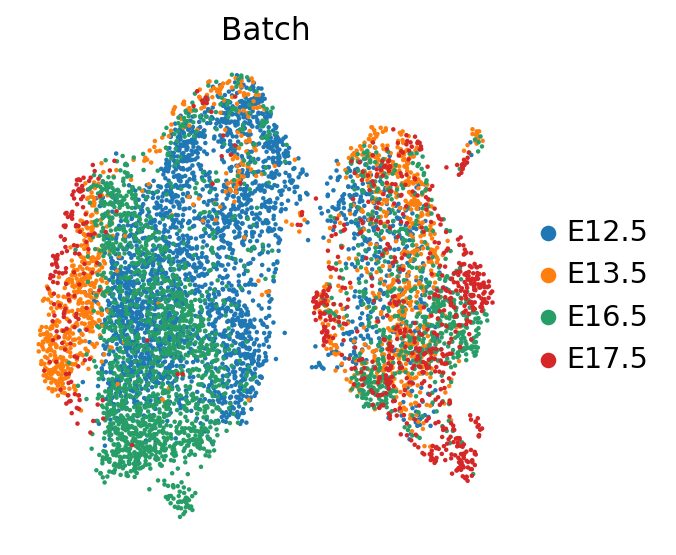

In [106]:
# Build neighborhood graph based on scANVi embedding and perform UMAP reduction
sc.pp.neighbors(emt2, use_rep='scANVI')
sc.tl.umap(emt2)
sc.pl.umap(emt2, color=['Batch'], wspace=0.5)

In [107]:
# Perform leiden clustering with varying resolution
sc.tl.leiden(emt2, key_added='leiden_res1', resolution=1.0)
sc.tl.leiden(emt2, key_added='leiden_res1_5', resolution=1.5)

/mnt/sdb/qdang/micromamba/envs/cellrank/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/mnt/sdb/qdang/micromamba/envs/cellrank/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


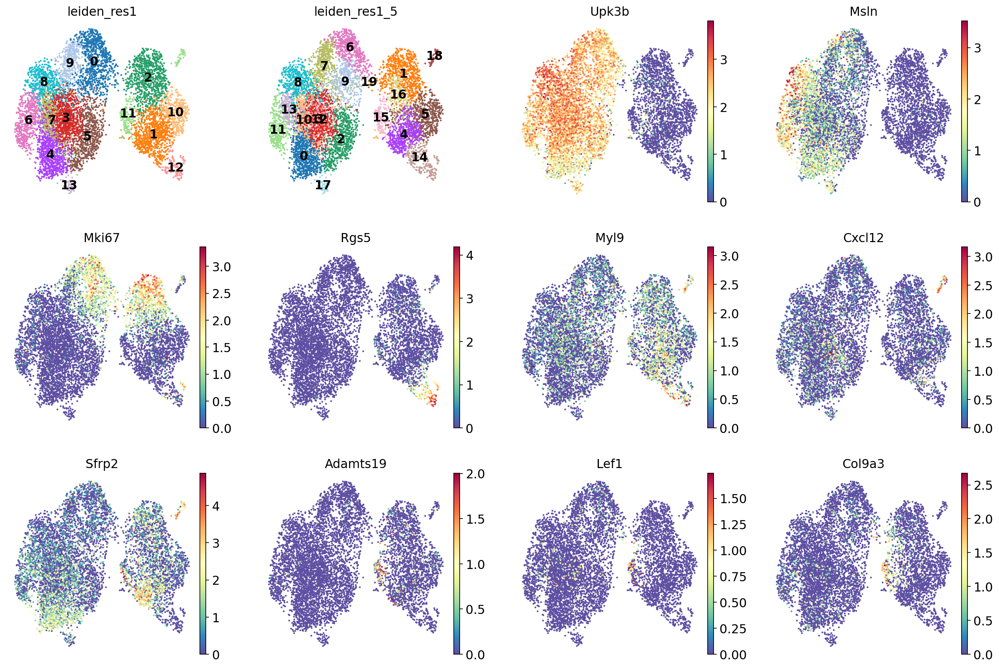

In [111]:
sc.pl.umap(emt2, color=['leiden_res1', 'leiden_res1_5',
                        'Upk3b','Msln', # epicardium markers
                        'Mki67', # proliferating cells
                         'Rgs5', # Pericyte markers
                         'Myl9','Cxcl12','Sfrp2', # synthetic SMC marker
                         'Adamts19','Lef1','Col9a3', # Valvular interstitial cell markers
                       ],layer='log1p_norm', frameon=False, legend_loc='on data')

# Merge clusters

In [24]:
import numpy as np
emt2.obs['leiden_res1_5'][emt2.obs['leiden_res1_5'].isin(['7', '9'])]='6'
emt2.obs['leiden_res1_5']=emt2.obs['leiden_res1_5'].astype('str').astype('category')
### Reorder and rename the Leiden
emt2.obs['leiden_res1_5'].cat.rename_categories(np.arange(len(np.unique(emt2.obs['leiden_res1_5']))).astype('str'), inplace=True)

/tmp/ipykernel_1891997/4110124539.py:5: FutureWarning: The `inplace` parameter in pandas.Categorical.rename_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  emt2.obs['leiden_res1_5'].cat.rename_categories(np.arange(len(np.unique(emt2.obs['leiden_res1_5']))).astype('str'), inplace=True)


/home/qdang/micromamba/envs/bioinfo/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


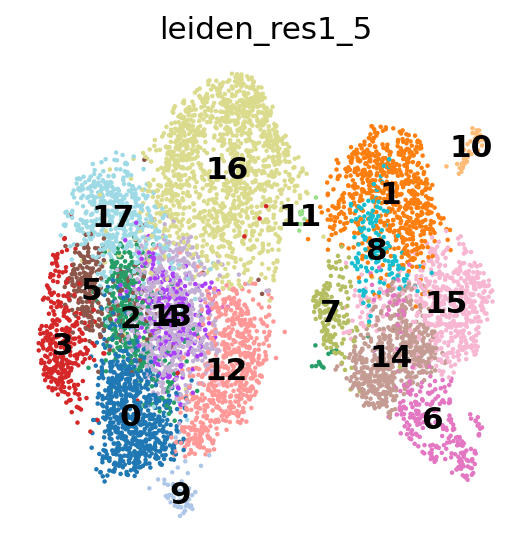

In [25]:
sc.pl.umap(emt2, color=['leiden_res1_5'],layer='log1p_norm', frameon=False, legend_loc='on data')

In [26]:
emt2.obs['leiden_res1_5'][emt2.obs['leiden_res1_5'].isin(['2','3','5','9','4','13','12','17'])]='0'
emt2.obs['leiden_res1_5']=emt2.obs['leiden_res1_5'].astype('str').astype('category')
### Reorder and rename the Leiden
emt2.obs['leiden_res1_5'].cat.rename_categories(np.arange(len(np.unique(emt2.obs['leiden_res1_5']))).astype('str'), inplace=True)

/tmp/ipykernel_1891997/556403273.py:4: FutureWarning: The `inplace` parameter in pandas.Categorical.rename_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  emt2.obs['leiden_res1_5'].cat.rename_categories(np.arange(len(np.unique(emt2.obs['leiden_res1_5']))).astype('str'), inplace=True)


/home/qdang/micromamba/envs/bioinfo/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


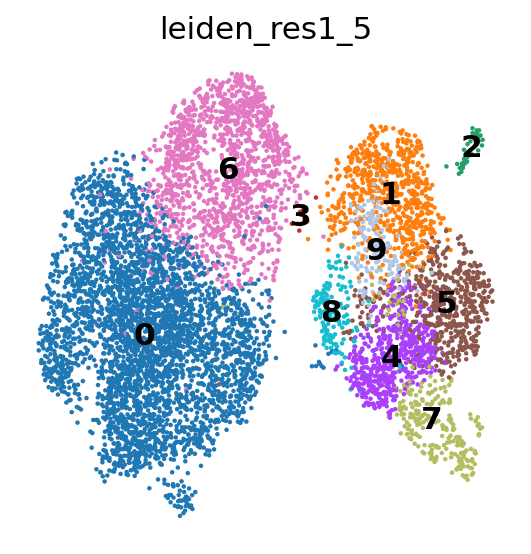

In [27]:
sc.pl.umap(emt2, color=['leiden_res1_5'],layer='log1p_norm', frameon=False, legend_loc='on data')

In [28]:
emt2.obs['leiden_res1_5'][emt2.obs['leiden_res1_5']=='9']='1'
emt2.obs['leiden_res1_5']=emt2.obs['leiden_res1_5'].astype('str').astype('category')
### Reorder and rename the Leiden
emt2.obs['leiden_res1_5'].cat.rename_categories(np.arange(len(np.unique(emt2.obs['leiden_res1_5']))).astype('str'), inplace=True)

/tmp/ipykernel_1891997/3378033303.py:4: FutureWarning: The `inplace` parameter in pandas.Categorical.rename_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  emt2.obs['leiden_res1_5'].cat.rename_categories(np.arange(len(np.unique(emt2.obs['leiden_res1_5']))).astype('str'), inplace=True)


/home/qdang/micromamba/envs/bioinfo/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


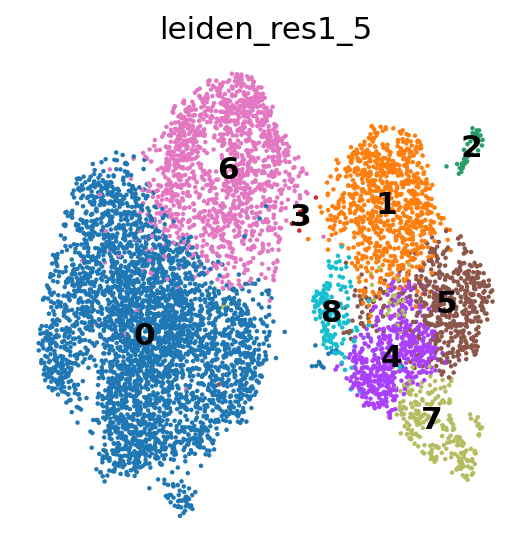

In [29]:
sc.pl.umap(emt2, color=['leiden_res1_5'], frameon=False, legend_loc='on data')

In [50]:
emt2.obs['leiden_res1_5'][emt2.obs['leiden_res1_5']=='6']='3'
emt2.obs['leiden_res1_5']=emt2.obs['leiden_res1_5'].astype('str').astype('category')
### Reorder and rename the Leiden
emt2.obs['leiden_res1_5'].cat.rename_categories(np.arange(len(np.unique(emt2.obs['leiden_res1_5']))).astype('str'), inplace=True)

/tmp/ipykernel_1891997/4037732936.py:4: FutureWarning: The `inplace` parameter in pandas.Categorical.rename_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  emt2.obs['leiden_res1_5'].cat.rename_categories(np.arange(len(np.unique(emt2.obs['leiden_res1_5']))).astype('str'), inplace=True)


/home/qdang/micromamba/envs/bioinfo/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


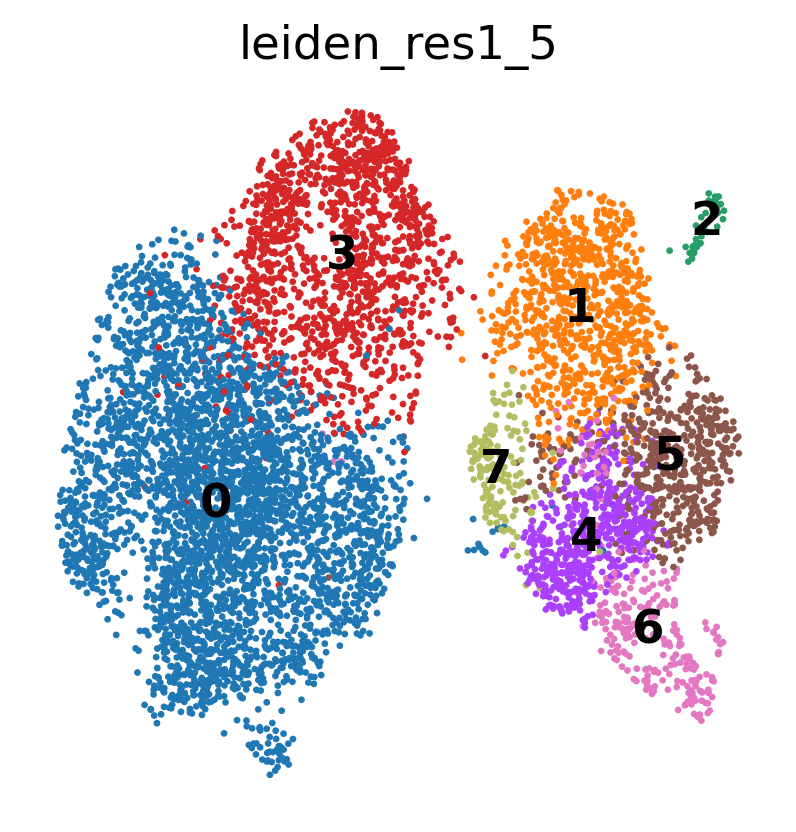

In [51]:
sc.pl.umap(emt2, color=['leiden_res1_5'], frameon=False, legend_loc='on data')

In [52]:
# create a dictionary to map cluster to annotation label
cluster2annotation = {
    "0": "Heart mesothelium/epicardium",
    "3": "Cycling epicardium",
    "6": "Pericyte",
    "5": "CFb/Fb progenitor",
    "1": "Cycling EPDC",
    "4": "EPDC",
    "7": "VIC",
    "2": "SMC progenitor"
}

# add a new `.obs` column called `cell type` by mapping clusters to annotation using pandas `map` function
emt2.obs["cell_type"] = emt2.obs["leiden_res1_5"].map(cluster2annotation).astype("category")

In [53]:
emt2.obs["cell_type"].value_counts()

Heart mesothelium/epicardium    3628
Cycling epicardium              1356
Cycling EPDC                     811
EPDC                             547
CFb/Fb progenitor                541
Pericyte                         255
VIC                              152
SMC progenitor                    42
Name: cell_type, dtype: int64

/home/qdang/micromamba/envs/bioinfo/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


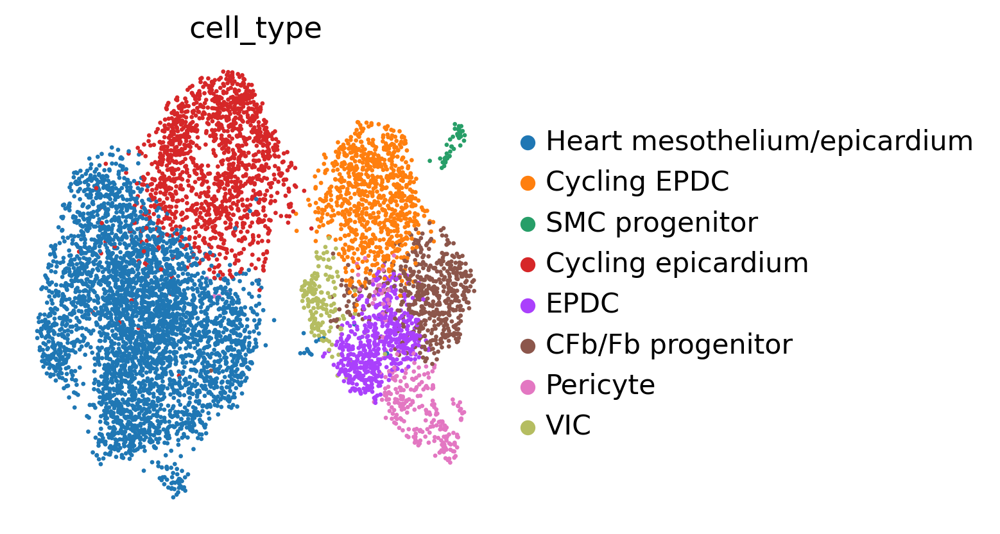

In [54]:
sc.pl.umap(emt2, color=['cell_type'], wspace=0.3, frameon=False)

# Perform pseudotime analysis using Palantir

In [2]:
palantir.__version__

'1.4.0'

In [3]:
ad = emt2.copy()

In [5]:
ad.X = ad.layers['counts'].copy()
ad.raw = ad
sc.pp.filter_genes(ad, min_cells=10)

In [7]:
palantir.preprocess.log_transform(ad)
print(ad.X)

  (0, 2)	6.149747119504681
  (0, 7)	3.4594316186372973
  (0, 8)	4.954196310386875
  (0, 9)	5.357552004618084
  (0, 12)	3.4594316186372973
  (0, 22)	6.507794640198696
  (0, 24)	5.357552004618084
  (0, 26)	3.4594316186372973
  (0, 33)	3.4594316186372973
  (0, 38)	5.357552004618084
  (0, 39)	4.39231742277876
  (0, 44)	3.4594316186372973
  (0, 46)	7.03342300153745
  (0, 55)	4.39231742277876
  (0, 56)	3.4594316186372973
  (0, 57)	4.954196310386875
  (0, 62)	3.4594316186372973
  (0, 64)	3.4594316186372973
  (0, 77)	3.4594316186372973
  (0, 79)	3.4594316186372973
  (0, 97)	4.39231742277876
  (0, 109)	5.357552004618084
  (0, 145)	5.357552004618084
  (0, 151)	3.4594316186372973
  (0, 155)	4.954196310386875
  :	:
  (7331, 17340)	3.4594316186372973
  (7331, 17342)	3.4594316186372973
  (7331, 17349)	3.4594316186372973
  (7331, 17351)	3.4594316186372973
  (7331, 17352)	4.954196310386875
  (7331, 17359)	4.39231742277876
  (7331, 17365)	3.4594316186372973
  (7331, 17369)	4.39231742277876
  (7331, 173

In [8]:
#Determine the diffusion map, generate low-dimensional embedding, and perform MAGIC imputatiob
dm_res = palantir.utils.run_diffusion_maps(ad, n_components=20)
ms_data = palantir.utils.determine_multiscale_space(ad)
imputed_X = palantir.utils.run_magic_imputation(ad)

In [11]:
# Find early cells by selecting cells at the extreme of the diffusion component
early_cell = palantir.utils.early_cell(ad, celltype="Cycling epicardium", celltype_column="cell_type")
early_cell

Using TTTGCGCGTACGACCC-1 for cell type Cycling epicardium which is min in diffusion component 7.


'TTTGCGCGTACGACCC-1'

In [12]:
# Find terminal cells by selecting cells at the extreme of the diffusion component
palantir.utils.find_terminal_states(ad, celltypes=["Heart mesothelium/epicardium",'CFb/Fb progenitor','Pericyte', 'VIC'
                                    ], celltype_column="cell_type")

Using CGGAGCTGTACATGTC-1 for cell type Heart mesothelium/epicardium which is max in diffusion component 0.
Using CTACTATTCACGTAGT-1 for cell type CFb/Fb progenitor which is min in diffusion component 0.
Using TACCTGCAGGTATTGA-1 for cell type Pericyte which is max in diffusion component 8.
Using GTAGCTACACGCACCA-1 for cell type VIC which is min in diffusion component 11.


CGGAGCTGTACATGTC-1    Heart mesothelium/epicardium
CTACTATTCACGTAGT-1               CFb/Fb progenitor
TACCTGCAGGTATTGA-1                        Pericyte
GTAGCTACACGCACCA-1                             VIC
dtype: object

In [17]:
# Define the initial cell and run the Palantir algorithm. Palantir requires having an early cell to estimate shortest paths #
# and identify cells spanning the differential landscape #
start_cell = "TTTGCGCGTACGACCC-1"
pr_res = palantir.core.run_palantir(
    ad, start_cell, num_waypoints=ad.shape[0]//3, n_jobs=25, terminal_states=terminal_states
)

Sampling and flocking waypoints...
Time for determining waypoints: 0.026569143931070963 minutes
Determining pseudotime...
Shortest path distances using 30-nearest neighbor graph...
Time for shortest paths: 0.20137211084365844 minutes
Iteratively refining the pseudotime...
Correlation at iteration 1: 0.9999
Entropy and branch probabilities...
Markov chain construction...
Computing fundamental matrix and absorption probabilities...
Project results to all cells...


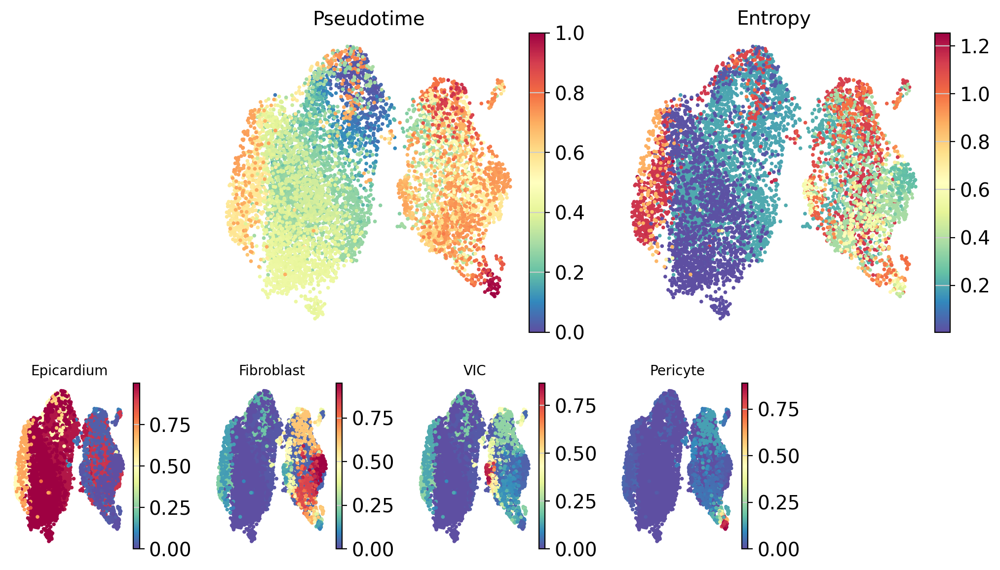

In [18]:
palantir.plot.plot_palantir_results(ad, s=3)
plt.show()

# We then use CellRank to visualise gene expression trends along epicardial branched lineages. Cellrank will first compute first probabilities, then group cells to specific trajectories based on their probability to reach particular terminal states. 

In [ ]:
# Fix an error that would prevent pandas>2.0 from operating 
import pandas as pd
pd.DataFrame.iteritems = pd.DataFrame.items

In [29]:
adata = ad.copy()
adata

AnnData object with n_obs × n_vars = 7332 × 17410
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'scDblFinder_score', 'scDblFinder_class', 'Batch', 'n_genes', 'leiden_res0_25', 'leiden_res0_5', 'leiden_res1', 'celltypist_cell_label_PRJNA795900', 'celltypist_conf_score_PRJNA795900', '_scvi_batch', '_scvi_labels', 'leiden_res1_25', 'leiden_res1_5', 'cell_type', 'palantir_pseudotime', 'palantir_entropy'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'n_cells'
    uns: 'Batch_colors', 'DM_EigenValues', '_scvi_manager_uuid', '_scvi_uuid', 'celltypist_cell_label_PRJNA795900_colors', 'hvg', 'leiden', 'leiden_res0_5_colors', 'leiden_res1_colors', '

Computing transition matrix based on pseudotime


100%|████████████████████████████████████████████████████████████| 7332/7332 [00:02<00:00, 3517.33cell/s]


    Finish (0:00:02)
PseudotimeKernel[n=7332]
Projecting transition matrix onto `umap`
Adding `adata.obsm['T_fwd_umap']`
    Finish (0:00:01)
figure cannot be saved as pdf, using png instead (can only output finite numbers in pdf).
saving figure to file ./figures/scvelo_updated_palantir_matrix_emt.png


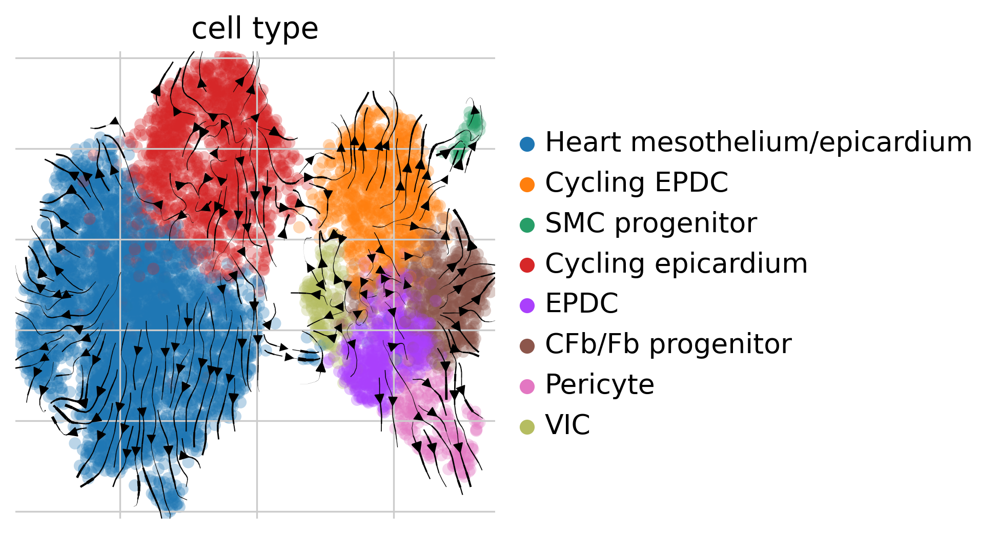

In [42]:
pk = cr.kernels.PseudotimeKernel(adata, time_key="palantir_pseudotime")
pk.compute_transition_matrix()

print(pk)
pk.plot_projection(color="cell_type", legend_loc="right", save='updated_palantir_matrix_emt.pdf')

In [44]:
# Initialise the GPCCA estimator to estimate macrostates. Refer to Cellrank2 documentation: https://cellrank.readthedocs.io/en/latest/notebooks/tutorials/general/100_getting_started.html
g = cr.estimators.GPCCA(pk)
print(g)

GPCCA[kernel=PseudotimeKernel[n=7332], initial_states=None, terminal_states=None]


Computing Schur decomposition
When computing macrostates, choose a number of states NOT in `[7, 9]`
Adding `adata.uns['eigendecomposition_fwd']`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:01:33)
Computing `11` macrostates
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:13)


/mnt/sdb/qdang/micromamba/envs/cellrank/lib/python3.10/site-packages/scvelo/plotting/scatter.py:656: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(
/mnt/sdb/qdang/micromamba/envs/cellrank/lib/python3.10/site-packages/scvelo/plotting/scatter.py:694: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/mnt/sdb/qdang/micromamba/envs/cellrank/lib/python3.10/site-packages/scvelo/plotting/utils.py:1391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(x, y, s=bg_size, marker=".", c=bg_color, zorder=zord - 2, **kwargs)
/mnt/sdb/qdang/micromamba/envs/cellrank/lib/python3.10/site-packages/scvelo/plotting/utils.py:1392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(x, y, s=gp_size, marker=".", c=gp_color, zorder=zord - 1, **kwargs)


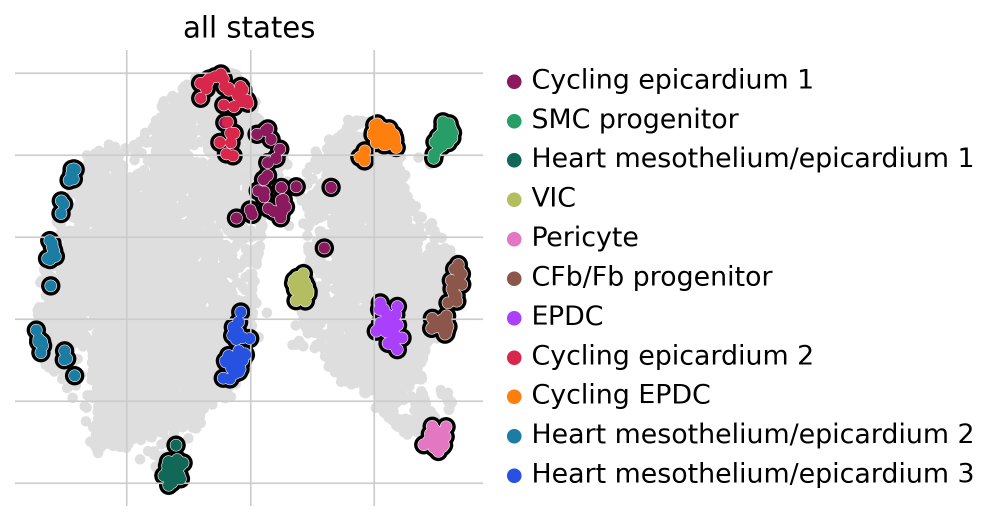

In [45]:
# Compute and plot macrostates
g.compute_macrostates(n_states=11, cluster_key="cell_type")
g.plot_macrostates(which="all", legend_loc="right", s=100)

Adding `adata.obs['term_states_fwd']`
       `adata.obs['term_states_fwd_probs']`
       `.terminal_states`
       `.terminal_states_probabilities`
       `.terminal_states_memberships
    Finish`


/mnt/sdb/qdang/micromamba/envs/cellrank/lib/python3.10/site-packages/scvelo/plotting/scatter.py:656: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(
/mnt/sdb/qdang/micromamba/envs/cellrank/lib/python3.10/site-packages/scvelo/plotting/scatter.py:694: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/mnt/sdb/qdang/micromamba/envs/cellrank/lib/python3.10/site-packages/scvelo/plotting/utils.py:1391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(x, y, s=bg_size, marker=".", c=bg_color, zorder=zord - 2, **kwargs)
/mnt/sdb/qdang/micromamba/envs/cellrank/lib/python3.10/site-packages/scvelo/plotting/utils.py:1392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(x, y, s=gp_size, marker=".", c=gp_color, zorder=zord - 1, **kwargs)


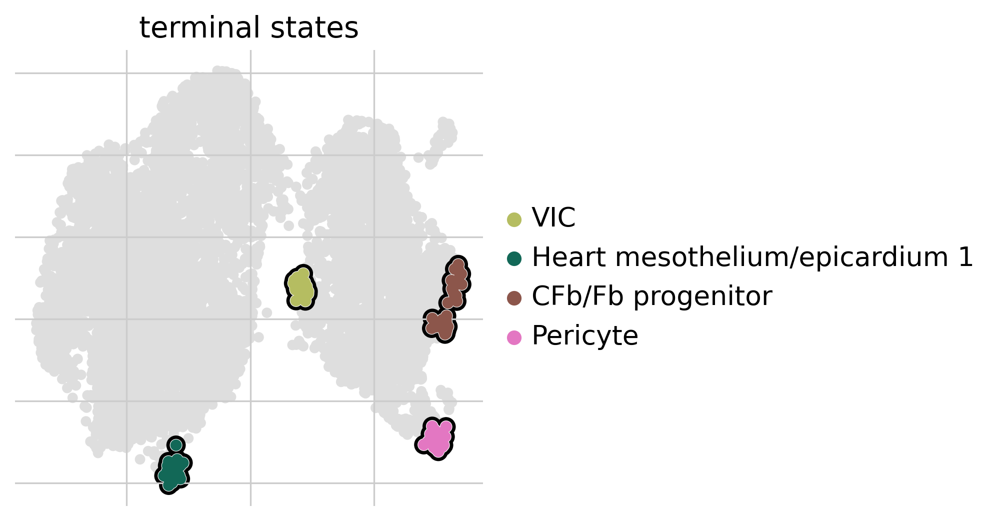

In [46]:
# Set the terminal states
g.set_terminal_states(states=["VIC", "Heart mesothelium/epicardium_1", "CFb/Fb progenitor", 'Pericyte'])
g.plot_macrostates(which="terminal", legend_loc="right", s=100)

Adding `adata.obs['init_states_fwd']`
       `adata.obs['init_states_fwd_probs']`
       `.initial_states`
       `.initial_states_probabilities`
       `.initial_states_memberships
    Finish`


/mnt/sdb/qdang/micromamba/envs/cellrank/lib/python3.10/site-packages/scvelo/plotting/scatter.py:656: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(
/mnt/sdb/qdang/micromamba/envs/cellrank/lib/python3.10/site-packages/scvelo/plotting/scatter.py:694: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/mnt/sdb/qdang/micromamba/envs/cellrank/lib/python3.10/site-packages/scvelo/plotting/utils.py:1391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(x, y, s=bg_size, marker=".", c=bg_color, zorder=zord - 2, **kwargs)
/mnt/sdb/qdang/micromamba/envs/cellrank/lib/python3.10/site-packages/scvelo/plotting/utils.py:1392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(x, y, s=gp_size, marker=".", c=gp_color, zorder=zord - 1, **kwargs)


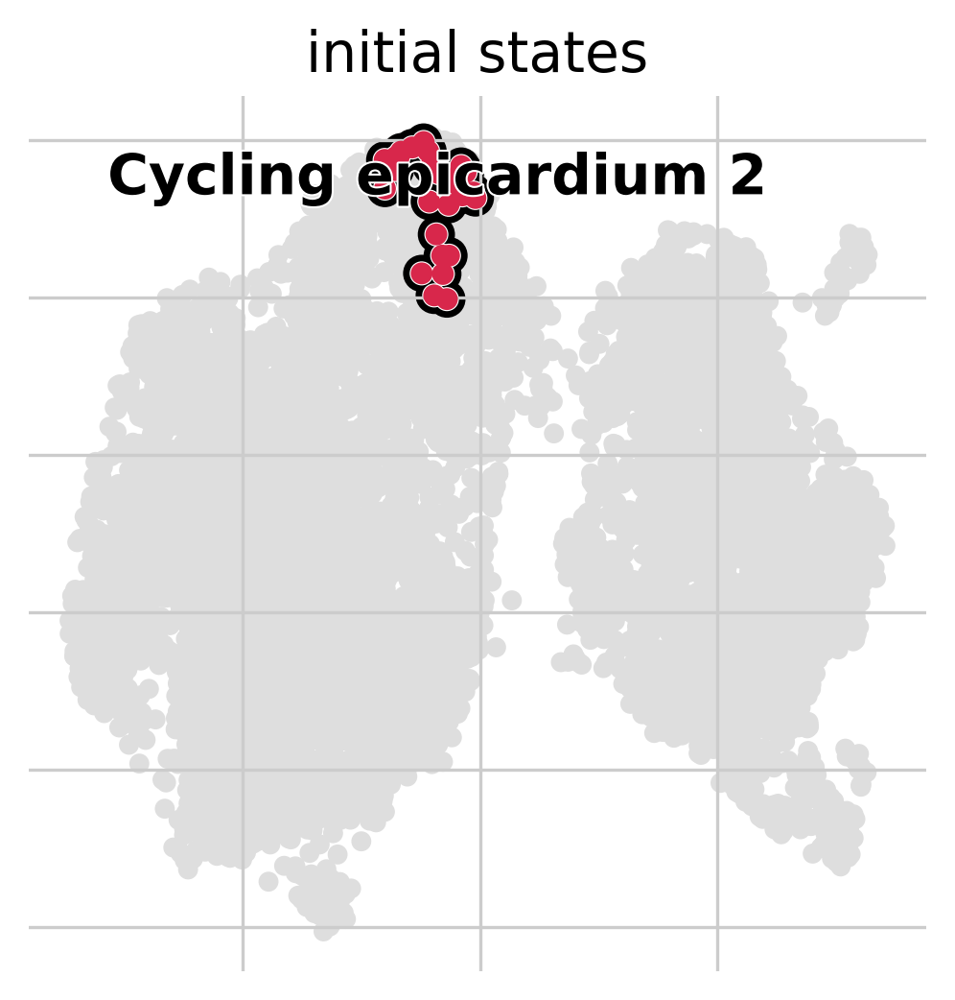

In [47]:
# Set the initial state
g.set_initial_states(states='Cycling epicardium_2')
g.plot_macrostates(which="initial", s=100)

Computing fate probabilities
Defaulting to `'gmres'` solver.


100%|████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00, 11.74/s]


Adding `adata.obsm['lineages_fwd']`
       `.fate_probabilities`
    Finish (0:00:00)


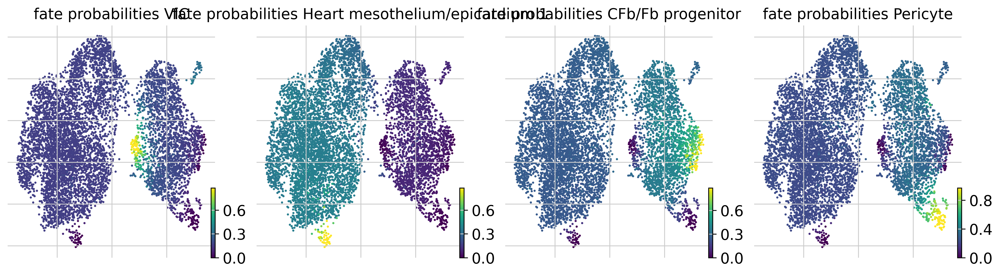

In [48]:
#Compute fate probabilities 
g.compute_fate_probabilities()
g.plot_fate_probabilities(same_plot=False)

In [53]:
# Initialise a model for GAM fitting. pyGam is chosen but you can select mgcv, which usually yields better performance for the authors
model = cr.models.GAMR(adata, n_knots=6, smoothing_penalty=10.0)

In [55]:
# Calculate the mean pseudotime per cell type
cluster_col = 'cell_type'  # or any clustering column like 'cell_type'
pseudotime_per_cluster = adata.obs.groupby(cluster_col)['palantir_pseudotime'].mean()
print(pseudotime_per_cluster)

cell_type
Heart mesothelium/epicardium    0.378332
Cycling EPDC                    0.568774
SMC progenitor                  0.689951
Cycling epicardium              0.208471
EPDC                            0.651562
CFb/Fb progenitor               0.585788
Pericyte                        0.706495
VIC                             0.612096
Name: palantir_pseudotime, dtype: float64


In [67]:
# Approximate the transition time between epicardial cells and EPDCs. We use a simple heuristic: The transition time is the mean of cell-type-specific pseudotime
mean_A = pseudotime_per_cluster['Cycling epicardium']
mean_B = pseudotime_per_cluster['EPDC']

transition_time = (mean_A + mean_B) / 2
print(f"Estimated transition time between A → B: {transition_time:.3f}")

Estimated transition time between A → B: 0.430


In [57]:
# Approximate the transition time between EPDCs and differentied fates (Pericytes)
mean_A = pseudotime_per_cluster['EPDC']
mean_B = pseudotime_per_cluster['Pericyte']

transition_time = (mean_A + mean_B) / 2
print(f"Estimated transition time between A → B: {transition_time:.3f}")

Estimated transition time between A → B: 0.679


In [58]:
# Approximate the transition time between EPDCs and differentied fates (Valvular interstitial cells)
mean_A = pseudotime_per_cluster['EPDC']
mean_B = pseudotime_per_cluster['VIC']

transition_time = (mean_A + mean_B) / 2
print(f"Estimated transition time between A → B: {transition_time:.3f}")

Estimated transition time between A → B: 0.632


In [59]:
# Approximate the transition time between EPDCs and differentied fates (cardiac fibroblast lineage)
mean_A = pseudotime_per_cluster['EPDC']
mean_B = pseudotime_per_cluster['CFb/Fb progenitor']

transition_time = (mean_A + mean_B) / 2
print(f"Estimated transition time between A → B: {transition_time:.3f}")

Estimated transition time between A → B: 0.619


Computing trends using `1` core(s)


100%|████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.11gene/s]

    Finish (0:00:01)


Plotting trends


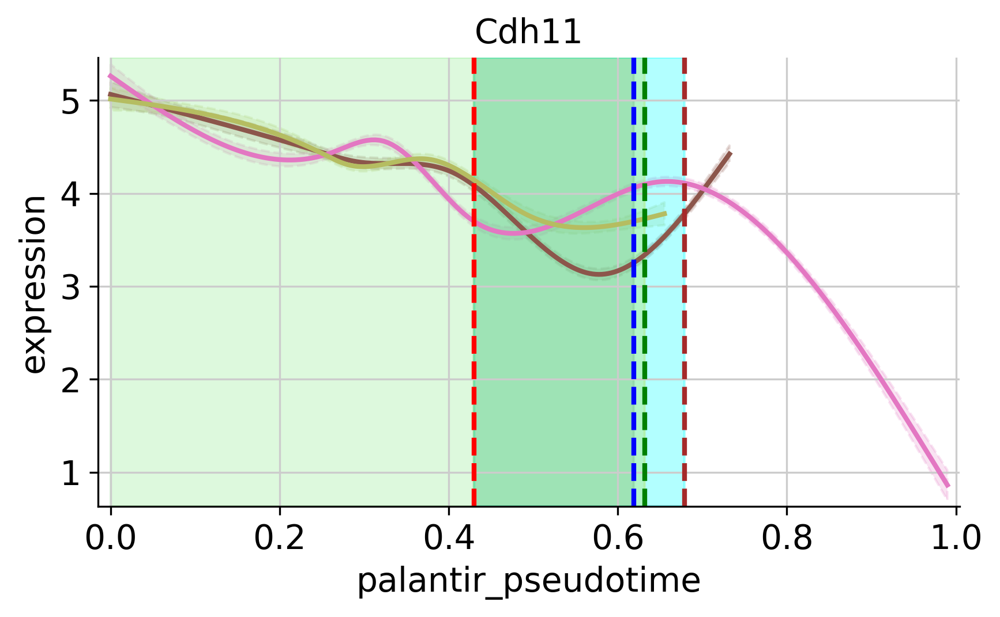

In [91]:
# Plot the gene expression trends
import matplotlib.pyplot as plt
cr.pl.gene_trends(
    adata,
    model=model,
    lineages=['CFb/Fb progenitor','Pericyte','VIC'],
    data_key='MAGIC_imputed_data',
    genes=["Cdh11"],
    same_plot=True,
    ncols=1,
    time_key="palantir_pseudotime",
    hide_cells=True,
    weight_threshold=(1e-3, 1e-3),legend_loc=None
)

# Get current axis
ax = plt.gca()

# Add vertical line
ax.axvline(x=0.430, color='red', linestyle='--', linewidth=2, label='Transition')

# Add second vertical line
ax.axvline(x=0.619, color='blue', linestyle='--', linewidth=2, label='End')

# Add third vertical line
ax.axvline(x=0.632, color='green', linestyle='--', linewidth=2, label='End')

# Add third vertical line
ax.axvline(x=0.679, color='brown', linestyle='--', linewidth=2, label='End')

# Shade area between the two lines
ax.axvspan(xmin=0, xmax=0.430, color='lightgreen', alpha=0.3, label='Transition Window')

# Shade area between the two lines
ax.axvspan(xmin=0.430, xmax=0.619, color='gray', alpha=0.3, label='Transition Window')

# Shade area between the two lines
ax.axvspan(xmin=0.430, xmax=0.632, color='gold', alpha=0.3, label='Transition Window')

# Shade area between the two lines
ax.axvspan(xmin=0.430, xmax=0.679, color='cyan', alpha=0.3, label='Transition Window')

# Show updated plot
plt.savefig('/mnt/sdb/qdang/singlecell/epi/integrated/emt/updated_pseudotime_cdh11.pdf', bbox_inches='tight', dpi=700)